# Load packages

In [7]:
import os
import pandas as pd
import numpy as np
import xml.etree.ElementTree as ET
from xml.dom import minidom
from tqdm import tqdm
import tifffile
import tifffile as tf
import numpy as np
import matplotlib.pyplot as plt
from skimage.registration import phase_cross_correlation
from scipy.ndimage import fourier_shift
from scipy.ndimage import shift
import cv2
import numpy as np
from sklearn.neighbors import NearestNeighbors
import cv2

import numpy as np
import cv2
from scipy.interpolate import Rbf
import matplotlib.pyplot as plt

import numpy as np
import cv2
from skimage.transform import PiecewiseAffineTransform, warp

import numpy as np
import cv2
from scipy.interpolate import Rbf

# 0. Define functions

In [8]:
# --- Normalize to 8-bit and build RGB ---
def normalize_uint16_to_uint8(img):
    
    return cv2.convertScaleAbs(img, alpha=(255.0 / 65535.0))

In [9]:
## first registration functions

def match_orb_features(img1, img2, nfeatures=10000, max_dist=400):
    """
    Detect and match ORB features between two images.

    Parameters:
    - img1, img2: Input images (grayscale or single-channel)
    - nfeatures: Number of ORB features to detect
    - max_dist: Maximum distance to keep good matches

    Returns:
    - good_matches: Filtered list of cv2.DMatch objects
    - kp1, kp2: Keypoints from img1 and img2
    - src_pts: Matched keypoints in img1 (Nx1x2)
    - dst_pts: Matched keypoints in img2 (Nx1x2)
    """
    # ORB detector
    orb = cv2.ORB_create(nfeatures=nfeatures)
    
    # Detect and compute descriptors
    kp1, des1 = orb.detectAndCompute(img1, None)
    kp2, des2 = orb.detectAndCompute(img2, None)
    
    # Brute-force matcher with Hamming distance
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    
    # Sort by distance
    matches = sorted(matches, key=lambda x: x.distance)
    
    # Filter by distance
    good_matches = [m for m in matches if m.distance < max_dist]
    
    # Extract point coordinates
    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    
    return good_matches, kp1, kp2, src_pts, dst_pts


def compute_homography_and_warp(img1, img2, src_pts, dst_pts, matches, ransac_thresh=3.0):
    """
    Estimate homography and warp img2 to align with img1 based on matched keypoints.

    Parameters:
    - img1, img2: Input images (img1 is reference)
    - src_pts: Keypoints in img1 (N x 1 x 2)
    - dst_pts: Corresponding keypoints in img2 (N x 1 x 2)
    - matches: List of cv2.DMatch objects
    - ransac_thresh: RANSAC reprojection threshold

    Returns:
    - H: Homography matrix
    - img2_aligned: Warped version of img2 aligned to img1
    - inlier_matches: Filtered matches that are consistent with the homography
    """
    H, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, ransac_thresh)

    inlier_matches = [m for m, inlier in zip(matches, mask.ravel()) if inlier]

    height, width = img1.shape[:2]
    img2_aligned = cv2.warpPerspective(img2, H, (width, height))

    return H, img2_aligned, inlier_matches

import numpy as np

def adjust_homography_scale(H, scale):
    """
    Adjust a homography matrix estimated on downscaled images 
    to apply it to full-resolution images.

    Parameters:
    - H: 3x3 homography matrix (estimated on downscaled images)
    - scale: float, downscaling factor (e.g., 0.25 if image was 4x smaller)

    Returns:
    - H_fullres: 3x3 homography matrix adjusted for full-resolution images
    """
    if H is None:
        raise ValueError("Input homography matrix H is None.")

    S = np.diag([1 / scale, 1 / scale, 1.0])  # Upscaling matrix
    H_fullres = S @ H @ np.linalg.inv(S)      # Scale-adjusted homography
    return H_fullres



In [10]:

def extract_and_warp_roi(img1, img2, x0, y0, size, H_fullres):
    """
    Extract ROI from two images, warp img2 ROI to img1 ROI using homography,
    convert to grayscale, and crop to valid overlapping region.

    Parameters:
    - img1: reference image (full resolution, color or grayscale)
    - img2: moving image (full resolution, color or grayscale)
    - x0, y0: top-left corner coordinates for ROI extraction
    - size: size of square ROI (int)
    - H_fullres: 3x3 homography matrix mapping img2 to img1 coordinates

    Returns:
    - tile_roi1_cropped: grayscale ROI from img1 cropped to valid overlap
    - tile_roi2_cropped: grayscale warped ROI from img2 cropped to valid overlap
    """

    # Extract ROI from both images
    tile_roi1 = img1[y0:y0+size, x0:x0+size]
    tile = img2[y0:y0+size, x0:x0+size]

    # Define ROI corner points (fullres coordinates)
    roi_corners = np.array([
        [x0, y0],
        [x0 + size, y0],
        [x0 + size, y0 + size],
        [x0, y0 + size]
    ], dtype=np.float32).reshape(-1, 1, 2)

    # Warp ROI corners with homography
    mapped_corners = cv2.perspectiveTransform(roi_corners, H_fullres)

    # Compute bounding box of mapped ROI (not directly used here, but could be)
    # x_min, y_min = np.min(mapped_corners[:, 0, :], axis=0).astype(int)
    # x_max, y_max = np.max(mapped_corners[:, 0, :], axis=0).astype(int)

    # Warp img2 ROI to img1 ROI coordinates (output size same as tile_roi1)
    tile_roi2 = cv2.warpPerspective(tile, H_fullres, (tile_roi1.shape[1], tile_roi1.shape[0]))

    # Convert to grayscale if needed
    if tile_roi1.ndim == 3 and tile_roi1.shape[2] == 3:
        tile_roi1 = cv2.cvtColor(tile_roi1, cv2.COLOR_BGR2GRAY)
    if tile_roi2.ndim == 3 and tile_roi2.shape[2] == 3:
        tile_roi2 = cv2.cvtColor(tile_roi2, cv2.COLOR_BGR2GRAY)

    # Create valid mask where warped tile has info (nonzero pixels)
    valid_mask = tile_roi2 > 0

    # Find bounding box of valid region in warped tile
    ys, xs = np.where(valid_mask)
    if len(xs) == 0 or len(ys) == 0:
        raise ValueError("No valid overlapping region found in warped tile.")

    x_min_valid, x_max_valid = xs.min(), xs.max()
    y_min_valid, y_max_valid = ys.min(), ys.max()

    # Crop both ROIs to the valid overlapping region
    tile_roi1_cropped = tile_roi1[y_min_valid:y_max_valid+1, x_min_valid:x_max_valid+1]
    tile_roi2_cropped = tile_roi2[y_min_valid:y_max_valid+1, x_min_valid:x_max_valid+1]

    return tile_roi1_cropped, tile_roi2_cropped


import cv2
import numpy as np

def akaze_feature_matching(tile_roi1, tile_roi2, ratio_thresh=0.8, ransac_thresh=500.0, verbose=True):
    """
    Perform AKAZE feature detection and matching between two images, then filter matches by Lowe's ratio test and RANSAC.
    
    Args:
        tile_roi1 (np.ndarray): First grayscale image (reference).
        tile_roi2 (np.ndarray): Second grayscale image (to match).
        ratio_thresh (float): Lowe's ratio test threshold (default 0.8).
        ransac_thresh (float): RANSAC reprojection threshold (default 500.0).
        verbose (bool): If True, print summary information.
        
    Returns:
        H (np.ndarray): Homography matrix estimated from inlier matches.
        good_matches (list of cv2.DMatch): List of inlier matches after RANSAC filtering.
        pts1 (np.ndarray): Matched points coordinates from first image (Nx2).
        pts2 (np.ndarray): Matched points coordinates from second image (Nx2).
        kp1 (list of cv2.KeyPoint): Keypoints in first image.
        kp2 (list of cv2.KeyPoint): Keypoints in second image.
    """
    # Initialize AKAZE detector
    detector = cv2.AKAZE_create(threshold=0.0005)
    kp1, des1 = detector.detectAndCompute(tile_roi1, None)
    kp2, des2 = detector.detectAndCompute(tile_roi2, None)

    # FLANN matcher setup for AKAZE (Lowe's recommended parameters)
    index_params = dict(algorithm=6, table_number=6, key_size=12, multi_probe_level=1)
    search_params = dict(checks=100)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Match descriptors with k=2 for ratio test
    matches = flann.knnMatch(des1, des2, k=2)
    
    # Apply Lowe's ratio test safely
    good_matches = [m for m_n in matches if len(m_n) == 2 for m, n in [m_n] if m.distance < ratio_thresh * n.distance]

    if len(good_matches) < 4:
        raise RuntimeError("Not enough good matches for homography estimation.")

    # Extract matched points
    pts1 = np.float32([kp1[m.queryIdx].pt for m in good_matches])
    pts2 = np.float32([kp2[m.trainIdx].pt for m in good_matches])

    # Estimate homography using RANSAC
    H, mask = cv2.findHomography(pts1, pts2, cv2.RANSAC, ransac_thresh)

    # Filter matches by inliers mask
    inlier_matches = [m for i, m in enumerate(good_matches) if mask[i]]

    # Update matched points for inliers only
    pts1 = np.float32([kp1[m.queryIdx].pt for m in inlier_matches])
    pts2 = np.float32([kp2[m.trainIdx].pt for m in inlier_matches])

    if verbose:
        print(f"Total matches: {len(good_matches)}; Inliers after RANSAC: {len(inlier_matches)}")

    return H, inlier_matches, pts1, pts2, kp1, kp2

from sklearn.neighbors import NearestNeighbors
import numpy as np
import cv2

def check_local_consistency(pts1, pts2, n_neighbors=5, error_thresh=3.0):
    """
    Check local geometric consistency of point correspondences using local affine transforms.

    Args:
        pts1 (np.ndarray): Nx2 array of points in image 1 (reference).
        pts2 (np.ndarray): Nx2 array of corresponding points in image 2 (aligned).
        n_neighbors (int): Number of neighbors to use for local transformation.
        error_thresh (float): Pixel error threshold for consistency.

    Returns:
        List[bool]: List of consistency flags for each point pair.
    """
    pts1 = np.asarray(pts1)
    pts2 = np.asarray(pts2)
    nbrs = NearestNeighbors(n_neighbors=n_neighbors, algorithm='auto').fit(pts1)
    local_consistency = []

    for i in range(len(pts1)):
        pt1 = pts1[i].reshape(1, -1)
        pt2 = pts2[i].reshape(1, -1)

        distances, indices = nbrs.kneighbors(pt1)
        neighbor_indices = indices[0]

        neigh_pts1 = pts1[neighbor_indices]
        neigh_pts2 = pts2[neighbor_indices]

        local_H, inliers = cv2.estimateAffinePartial2D(
            neigh_pts1, neigh_pts2, method=cv2.RANSAC, ransacReprojThreshold=error_thresh
        )

        if local_H is None:
            local_consistency.append(False)
            continue

        neigh_pts1_h = np.hstack([neigh_pts1, np.ones((len(neigh_pts1), 1))])
        transformed_pts1 = (local_H @ neigh_pts1_h.T).T
        errors = np.linalg.norm(transformed_pts1 - neigh_pts2, axis=1)
        consistent = np.mean(errors) < error_thresh
        local_consistency.append(consistent)

    return local_consistency

def piecewise_affine_warp(pts_src, pts_dst, image):
    """
    Warp the given image from pts_src to pts_dst using Piecewise Affine Transform.
    pts_src: Nx2 array of control points in the moving image
    pts_dst: Nx2 array of control points in the fixed/reference image
    image: input 2D image to warp (grayscale or single-channel)
    """
    # Define the transform
    tform = PiecewiseAffineTransform()
    tform.estimate(pts_src, pts_dst)

    # Warp the image
    warped_image = warp(image, tform, output_shape=image.shape, order=1, mode='constant', cval=0)

    # Convert to original dtype (e.g. uint8)
    if np.issubdtype(image.dtype, np.integer):
        warped_image = (warped_image * 255).astype(image.dtype)
    return warped_image


def tps_warp(pts_src, pts_dst, image_to_warp):
    """
    Apply Thin Plate Spline (TPS) warp from source to destination points.

    Parameters:
    - pts_src: Nx2 array of control points in the source image (moving image)
    - pts_dst: Nx2 array of control points in the target image (reference image)
    - image_to_warp: 2D NumPy array (grayscale) to warp

    Returns:
    - warped_image: 2D NumPy array of the warped image
    """
    # Separate coordinates
    x_src, y_src = pts_src[:, 0], pts_src[:, 1]
    x_dst, y_dst = pts_dst[:, 0], pts_dst[:, 1]

    # Create RBF interpolators
    rbf_x = Rbf(x_src, y_src, x_dst, function='thin_plate')
    rbf_y = Rbf(x_src, y_src, y_dst, function='thin_plate')

    # Create meshgrid of image_to_warp coordinates
    h, w = image_to_warp.shape
    grid_x, grid_y = np.meshgrid(np.arange(w), np.arange(h))
    points_grid = np.vstack([grid_x.ravel(), grid_y.ravel()]).T

    # Warp all points
    x_warped = rbf_x(points_grid[:, 0], points_grid[:, 1])
    y_warped = rbf_y(points_grid[:, 0], points_grid[:, 1])
    warped_points = np.vstack([x_warped, y_warped]).T

    # Build remap grids
    map_x = warped_points[:, 0].reshape(h, w).astype(np.float32)
    map_y = warped_points[:, 1].reshape(h, w).astype(np.float32)

    # Warp image
    warped_image = cv2.remap(
        image_to_warp,
        map_x,
        map_y,
        interpolation=cv2.INTER_LINEAR,
        borderMode=cv2.BORDER_CONSTANT,
        borderValue=0,
    )
    return warped_image


In [11]:
# plotting function

import cv2
import matplotlib.pyplot as plt

def plot_inlier_matches(img1, img2, kp1, kp2, matches, title="Inlier Matches", figsize=(12, 8)):
    """
    Draw and display inlier feature matches between two images.

    Parameters:
    - img1, img2: Input images
    - kp1, kp2: Keypoints from img1 and img2
    - matches: List of cv2.DMatch objects (e.g., inlier matches)
    - title: Title for the plot
    - figsize: Size of the matplotlib figure

    Returns:
    - img_matches: Image with drawn matches (BGR format)
    """
    img_matches = cv2.drawMatches(
        img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )
    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.axis("off")
    plt.show()

import numpy as np
import cv2
import matplotlib.pyplot as plt

def plot_overlay(tile_roi1, tile_roi2, figsize=(10, 10), title="Overlay: Reference (Green) & Registered (Magenta)"):
    """
    Create and plot an RGB overlay image:
    - Reference image in green channel
    - Registered image in magenta (red + blue channels)
    
    Parameters:
    - tile_roi1: 2D array, reference grayscale image
    - tile_roi2: 2D array, registered grayscale image
    - figsize: tuple, figure size
    - title: str, plot title
    """
    # Ensure images are float32 for overlay composition
    tile_roi1 = tile_roi1.astype(np.float32)
    tile_roi2 = tile_roi2.astype(np.float32)

    # Initialize empty RGB overlay
    overlay = np.zeros((tile_roi1.shape[0], tile_roi1.shape[1], 3), dtype=np.float32)
    overlay[..., 1] = tile_roi1  # Green channel for reference
    overlay[..., 0] = tile_roi2  # Red channel for registered
    overlay[..., 2] = tile_roi2  # Blue channel for registered

    # Normalize overlay to [0, 255]
    max_val = np.max(overlay)
    if max_val == 0:
        max_val = 1  # avoid division by zero

    overlay_uint8 = cv2.convertScaleAbs(overlay, alpha=(255.0 / max_val))

    # Plot
    plt.figure(figsize=figsize)
    plt.imshow(overlay_uint8)
    plt.title(title)
    plt.axis('off')
    plt.show()

import cv2
import numpy as np
import matplotlib.pyplot as plt

def plot_match_consistency(tile_roi1, tile_roi2, kp1, kp2, consistent_matches, inconsistent_matches, title="Matches: Green = consistent; Magenta = inconsistent"):
    """
    Plot consistent and inconsistent feature matches between two image tiles.

    Parameters:
    - tile_roi1: Grayscale or RGB image patch from image 1.
    - tile_roi2: Grayscale or RGB image patch from image 2.
    - kp1: Keypoints from image 1.
    - kp2: Keypoints from image 2.
    - consistent_matches: List of cv2.DMatch objects for consistent matches.
    - inconsistent_matches: List of cv2.DMatch objects for inconsistent matches.
    - title: Title of the plot (default provided).
    """
    
    # Draw consistent matches in green
    img_matches = cv2.drawMatches(
        tile_roi1, kp1,
        tile_roi2, kp2,
        consistent_matches, None,
        matchColor=(0, 255, 0),  # Green
        singlePointColor=None,
        matchesThickness=8,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )

    # Draw inconsistent matches in magenta (red + blue)
    img_matches = cv2.drawMatches(
        tile_roi1, kp1,
        tile_roi2, kp2,
        inconsistent_matches, img_matches,
        matchColor=(255, 0, 255),  # Magenta
        singlePointColor=None,
        matchesThickness=8,
        flags=cv2.DrawMatchesFlags_DRAW_OVER_OUTIMG | cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS
    )

    # Convert BGR to RGB for matplotlib
    img_matches = cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB)

    # Plot
    plt.figure(figsize=(20, 10))
    plt.imshow(img_matches)
    plt.title(title)
    plt.axis('off')
    plt.show()


# Process images

In [14]:
# put paths here:
img_path = '/lustre/groups/ml01/workspace/mostafa.shahhosseini/data/MMann/roi_whole_slide/'

In [25]:
# Load ch1, ch2, ch3 for Round 0
img1_ch1 = tf.imread(os.path.join(img_path, 'Round0_ch0.tif'))
img1_ch2 = tf.imread(os.path.join(img_path, 'Round0_ch1.tif'))
img1_ch3 = tf.imread(os.path.join(img_path, 'Round0_ch2.tif'))

# Load ch1, ch2, ch3 for Round 1
img2_ch1 = tf.imread(os.path.join(img_path, 'Round1_ch0.tif'))
img2_ch2 = tf.imread(os.path.join(img_path, 'Round1_ch1.tif'))
img2_ch3 = tf.imread(os.path.join(img_path, 'Round1_ch2.tif'))

In [17]:

img1_rgb = cv2.merge([
    normalize_uint16_to_uint8(img1_ch1+img1_ch2+img1_ch3),
    normalize_uint16_to_uint8(img1_ch1+img1_ch2+img1_ch3),
    normalize_uint16_to_uint8(img1_ch1+img1_ch2+img1_ch3)
])

img2_rgb = cv2.merge([
    normalize_uint16_to_uint8(img2_ch1+img2_ch2+img2_ch3),
    normalize_uint16_to_uint8(img2_ch1+img2_ch2+img2_ch3),
    normalize_uint16_to_uint8(img2_ch1+img2_ch2+img2_ch3)
])


img1_roi = img1_rgb[:, :]
img2_roi = img2_rgb[:, :]

# --- CLAHE on each channel ---
clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
img1_enh = cv2.merge([clahe.apply(c) for c in cv2.split(img1_roi)])
img2_enh = cv2.merge([clahe.apply(c) for c in cv2.split(img2_roi)])

# --- Downsample ---
scale = 0.01
img1_down = cv2.resize(img1_enh, None, fx=scale, fy=scale, interpolation=cv2.INTER_AREA)
img2_down = cv2.resize(img2_enh, None, fx=scale, fy=scale, interpolation=cv2.INTER_AREA)


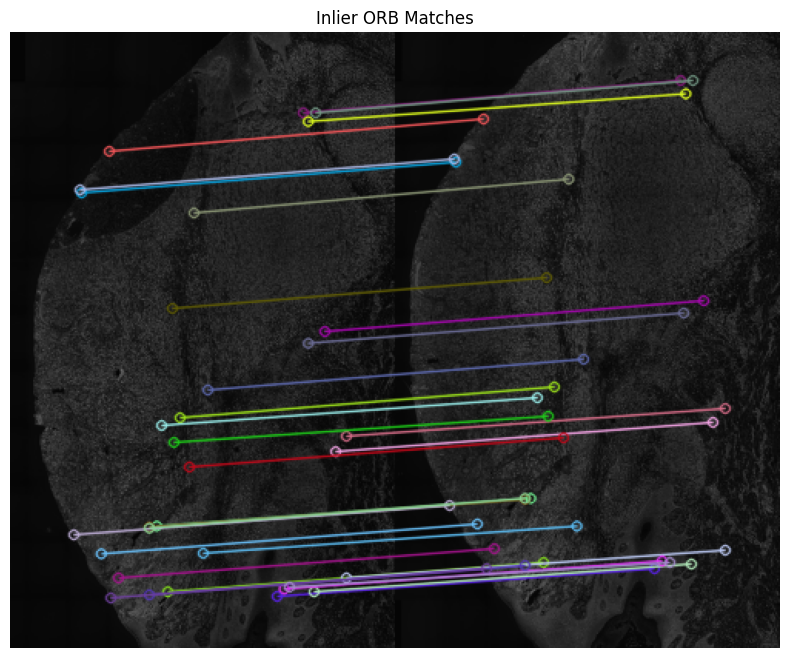

In [19]:

# Fint match_orb features
good_matches, kp1, kp2, src_pts, dst_pts = match_orb_features(img1_down, img2_down)


# Compute H (transformation) and apply it
H, img2_aligned, inlier_matches = compute_homography_and_warp(img1_down, img2_down, src_pts, dst_pts, good_matches, ransac_thresh=3.0)

# plot the identified ORB features
plot_inlier_matches(img1_down, img2_down, kp1, kp2, inlier_matches, title="Inlier ORB Matches")


# we also adjust H to the full resolution image
H_fullres=adjust_homography_scale(H, scale)



# We now start working with the ROI

In [20]:
x0, y0 = 10000, 20000
tile_size=8000
tile_roi1, tile_roi2 = extract_and_warp_roi(img1_enh, img2_enh, x0, y0, tile_size, H_fullres)

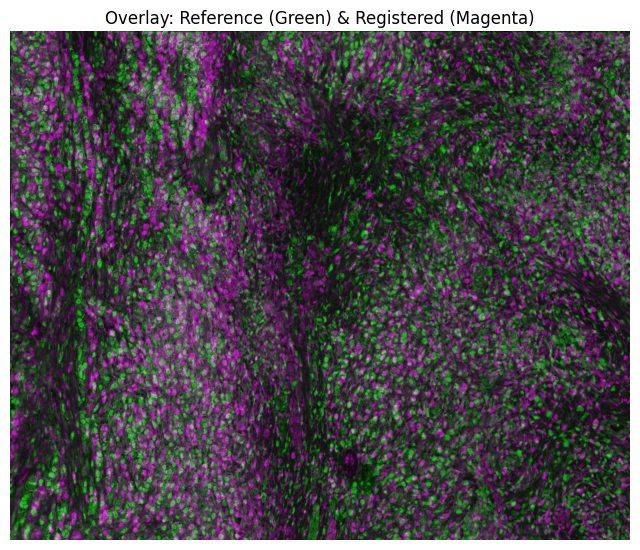

In [21]:
plot_overlay(tile_roi1, tile_roi2, figsize=(8, 8))

Total matches: 1084; Inliers after RANSAC: 82


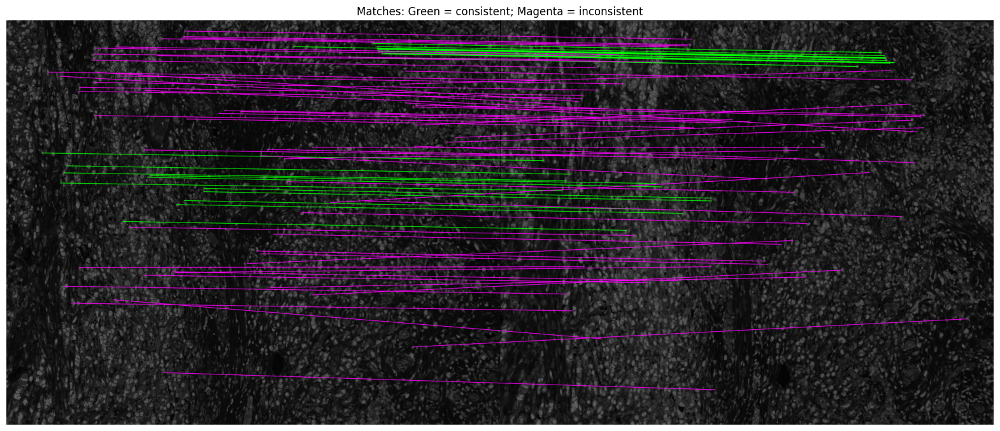

In [22]:
H, inliers, pts1, pts2, kp1, kp2 = akaze_feature_matching(tile_roi1, tile_roi2)


# Usage:
n_neighbors = 10
error_threshold = 50.0  # pixels, adjust based on your data
consistency_flags = check_local_consistency(pts1, pts2, n_neighbors, error_threshold)
consistent_matches = [m for m, c in zip(inliers, consistency_flags) if c]
inconsistent_matches = [m for m, c in zip(inliers,consistency_flags) if not c]
plot_match_consistency(tile_roi1, tile_roi2, kp1, kp2, consistent_matches, inconsistent_matches)


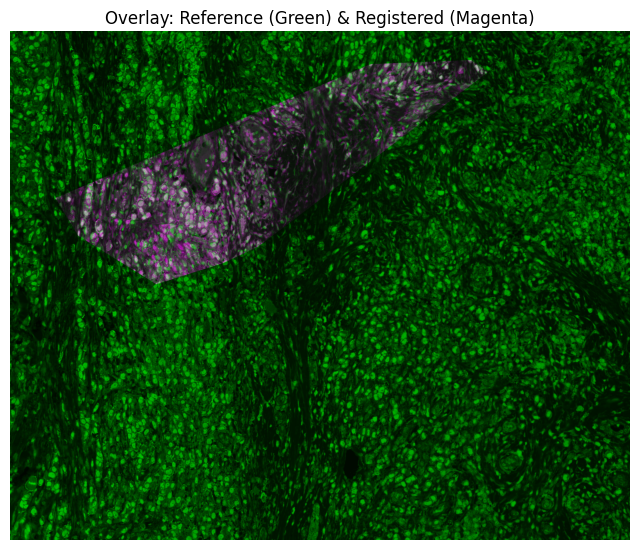

In [23]:
# 1. Extract matched points from keypoints and good matches
pts_mov = np.float32([kp1[m.queryIdx].pt for m in consistent_matches])  # from roi1_gray (reference)
pts_ref = np.float32([kp2[m.trainIdx].pt for m in consistent_matches])  # from roi2_gray (moving)
roi2_tsp_warped = piecewise_affine_warp(pts_mov, pts_ref, tile_roi2)
# overlay
plot_overlay(tile_roi1, roi2_tsp_warped, figsize=(8, 8))

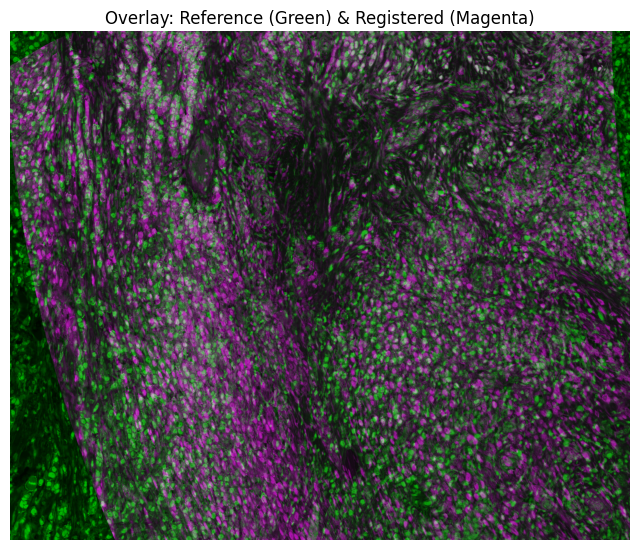

In [281]:
# Assume consistent_matches, kp1, kp2, tile_roi1, tile_roi2 are already defined
pts_mov = np.float32([kp1[m.queryIdx].pt for m in consistent_matches])  # moving
pts_ref = np.float32([kp2[m.trainIdx].pt for m in consistent_matches])  # reference

roi2_tps_warped = tps_warp(pts_mov, pts_ref, tile_roi2)
# Overlay and visualize
plot_overlay(tile_roi1, roi2_tps_warped, figsize=(8, 8))


# Work per channel

In [327]:
x0, y0 = 10000, 20000
tile_size=6000
tile_roi1, tile_roi2 = extract_and_warp_roi(img1_ch1, img2_ch1, x0, y0, tile_size, H_fullres)

In [328]:
### normalize channels and convert to 8 bit

tile_roi1=normalize_uint16_to_uint8(tile_roi1)
tile_roi2=normalize_uint16_to_uint8(tile_roi2)
# --- CLAHE on each channel ---
clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
tile_roi1 = cv2.merge([clahe.apply(c) for c in cv2.split(tile_roi1)])
tile_roi2 = cv2.merge([clahe.apply(c) for c in cv2.split(tile_roi2)])

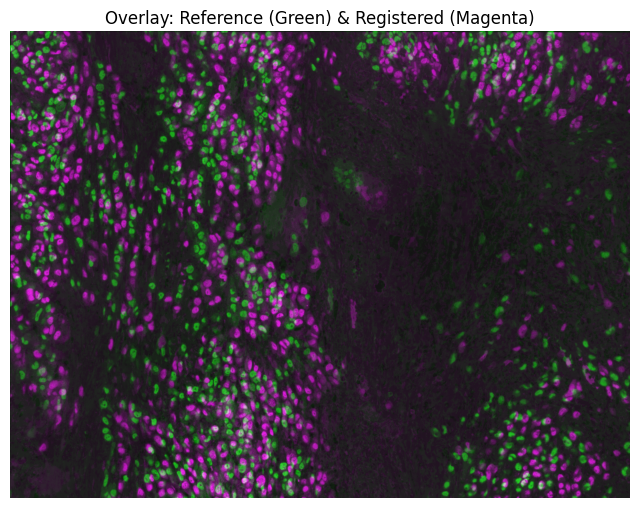

In [329]:
plot_overlay(tile_roi1, tile_roi2, figsize=(8, 8))

Total matches: 199; Inliers after RANSAC: 59


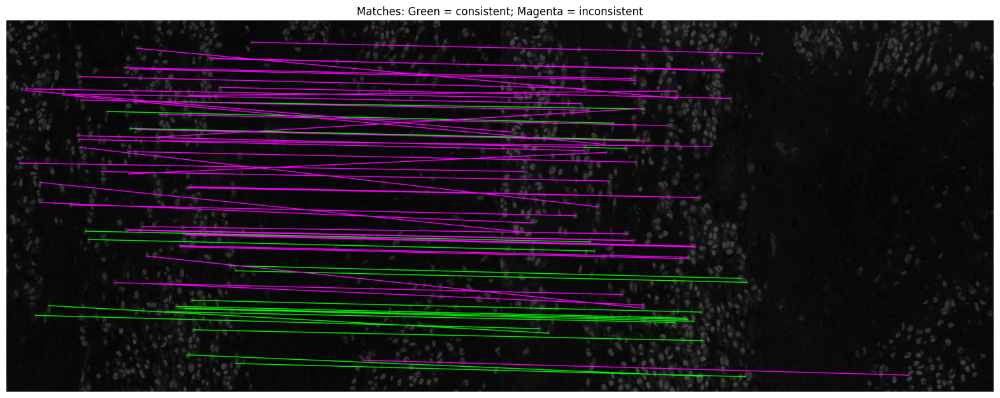

In [330]:
H, inliers, pts1, pts2, kp1, kp2 = akaze_feature_matching(tile_roi1, tile_roi2,ratio_thresh=0.8, ransac_thresh=500.0)

# Usage:
n_neighbors = 5
error_threshold = 50.0  # pixels, adjust based on your data
consistency_flags = check_local_consistency(pts1, pts2, n_neighbors, error_threshold)
consistent_matches = [m for m, c in zip(inliers, consistency_flags) if c]
inconsistent_matches = [m for m, c in zip(inliers,consistency_flags) if not c]
# Convert to 8-bit if needed
plot_match_consistency(tile_roi1, tile_roi2, kp1, kp2, consistent_matches, inconsistent_matches)


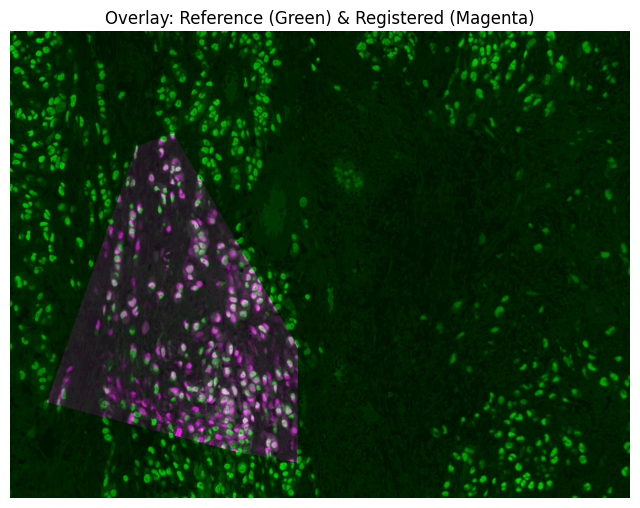

In [331]:
# 1. Extract matched points from keypoints and good matches
pts_mov = np.float32([kp1[m.queryIdx].pt for m in consistent_matches])  # from roi1_gray (reference)
pts_ref = np.float32([kp2[m.trainIdx].pt for m in consistent_matches])  # from roi2_gray (moving)
roi2_tsp_warped = piecewise_affine_warp(pts_mov, pts_ref, tile_roi2)
# overlay
plot_overlay(tile_roi1, roi2_tsp_warped, figsize=(8, 8))

# Combining features

Processing merged image...
Total matches: 264; Inliers after RANSAC: 81
Processing channel 1...
Total matches: 85; Inliers after RANSAC: 38
Processing channel 2...
Total matches: 81; Inliers after RANSAC: 40
Processing channel 3...
Total matches: 86; Inliers after RANSAC: 26
Total combined matches before global consistency check: 20
After global consistency filtering: 20 matches retained


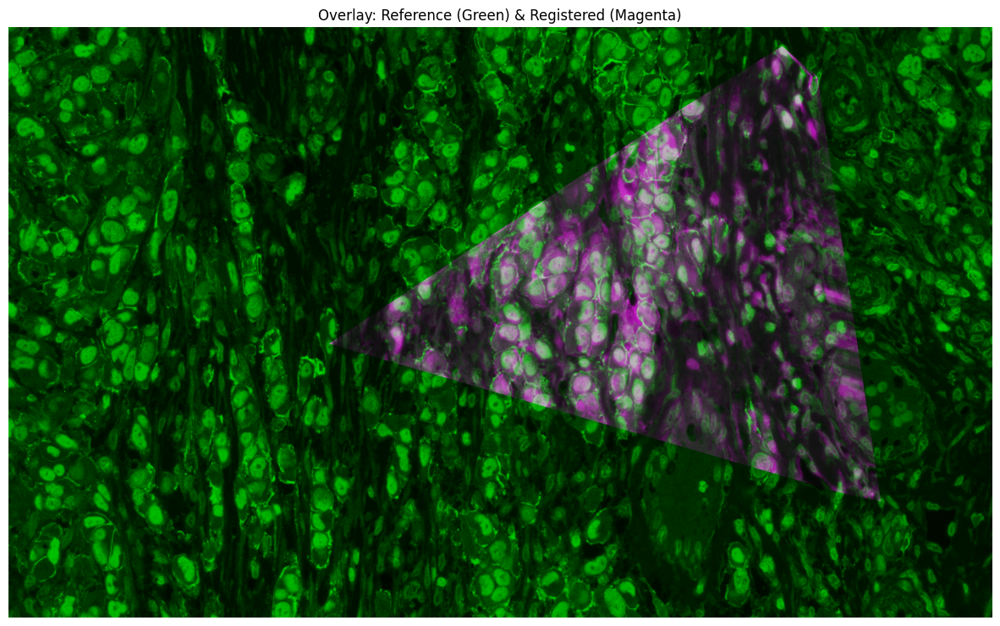

In [26]:
def normalize_and_clahe(tile):
    tile = normalize_uint16_to_uint8(tile)
    clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
    return cv2.merge([clahe.apply(c) for c in cv2.split(tile)])

def get_consistent_matches(tile1, tile2, label=""):
    try:
        H, inliers, pts1, pts2, kp1, kp2 = akaze_feature_matching(tile1, tile2, ratio_thresh=0.8, ransac_thresh=500.0)
        consistency_flags = check_local_consistency(pts1, pts2, n_neighbors, error_threshold)
        consistent_matches = [m for m, c in zip(inliers, consistency_flags) if c]
        return consistent_matches, kp1, kp2
    except Exception as e:
        print(f"[Warning] {label}: failed to match — {e}")
        return [], [], []


# input should be
x0, y0 = 10000, 20000
tile_size = 4000

n_neighbors=5
error_threshold=50.0

# Step 1: Extract and normalize merged channel
tile_roi1_merged, tile_roi2_merged = extract_and_warp_roi(img1_enh, img2_enh, x0, y0, tile_size, H_fullres)
all_pts1 = []
all_pts2 = []

# Process merged
print("Processing merged image...")
matches, kp1, kp2 = get_consistent_matches(tile_roi1_merged, tile_roi2_merged, label="merged")
for m in matches:
    all_pts1.append(kp1[m.queryIdx].pt)
    all_pts2.append(kp2[m.trainIdx].pt)

# Step 2: Process each individual channel
for i, (ch1, ch2) in enumerate(zip(
    [img1_ch1, img1_ch2, img1_ch3],
    [img2_ch1, img2_ch2, img2_ch3]
), start=1):
    print(f"Processing channel {i}...")
    try:
        tile_roi1_ch, tile_roi2_ch = extract_and_warp_roi(ch1, ch2, x0, y0, tile_size, H_fullres)
        tile_roi1_ch = normalize_and_clahe(tile_roi1_ch)
        tile_roi2_ch = normalize_and_clahe(tile_roi2_ch)
        matches, kp1, kp2 = get_consistent_matches(tile_roi1_ch, tile_roi2_ch, label=f"channel {i}")
        for m in matches:
            all_pts1.append(kp1[m.queryIdx].pt)
            all_pts2.append(kp2[m.trainIdx].pt)
    except Exception as e:
        print(f"[Warning] Channel {i}: extraction or normalization failed — {e}")

# Step 3: Combine and filter again globally
pts1 = np.float32(all_pts1)
pts2 = np.float32(all_pts2)
print(f"Total combined matches before global consistency check: {len(pts1)}")

if len(pts1) < n_neighbors + 1:
    print("[Error] Not enough combined matches for global consistency filtering.")

consistency_flags = check_local_consistency(pts1, pts2, n_neighbors, error_threshold)
pts1_consistent = pts1[consistency_flags]
pts2_consistent = pts2[consistency_flags]
print(f"After global consistency filtering: {len(pts1_consistent)} matches retained")

# Step 4: Warp and overlay
warped = piecewise_affine_warp(pts1_consistent, pts2_consistent, tile_roi2_merged)
plot_overlay(tile_roi1_merged, warped, figsize=(15, 15))


pts1_global = pts1_consistent + np.array([x0, y0])
pts2_global = pts2_consistent + np.array([x0, y0])
# 
H_inv = np.linalg.inv(H_fullres)
# Convert to homogeneous coordinates and map back
pts2_global_original = cv2.perspectiveTransform(pts2_global[None, :, :], H_inv)[0]


# the output should be should be:
##--pts1_global and pt2_global_original


## Plotting

Processing channel 1...


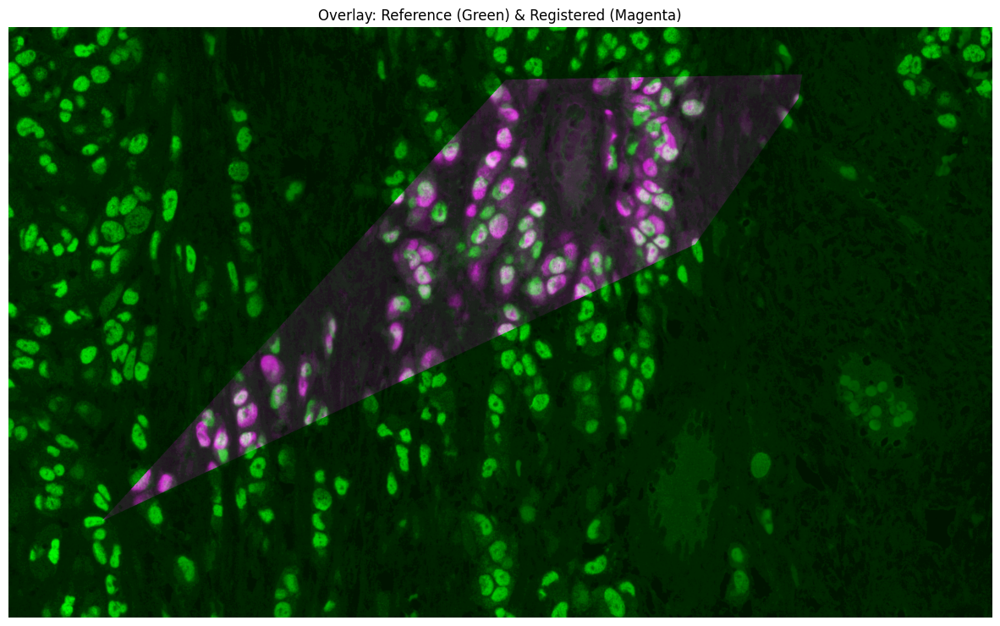

Processing channel 2...


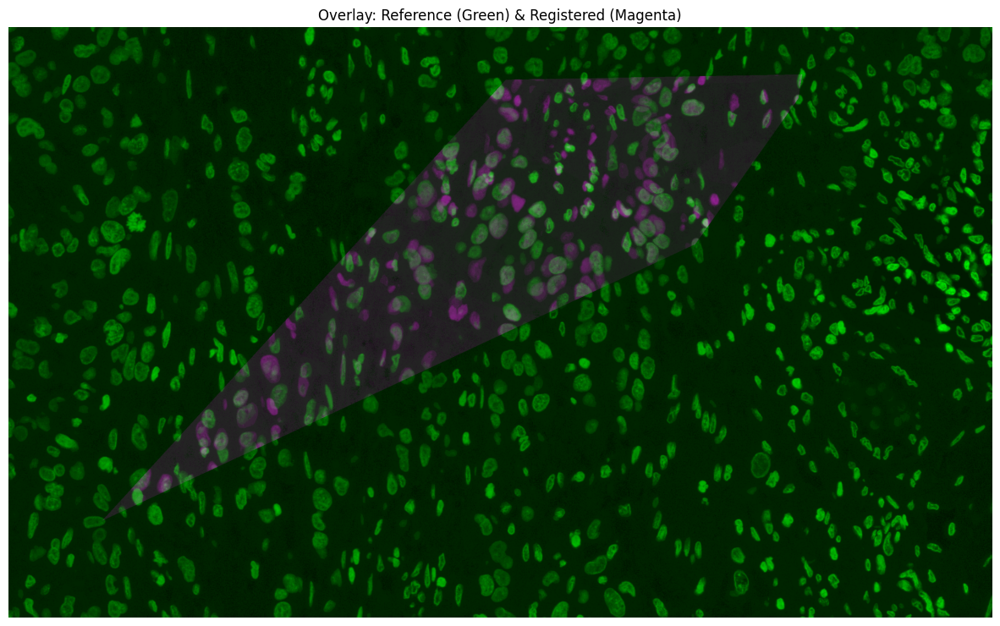

Processing channel 3...


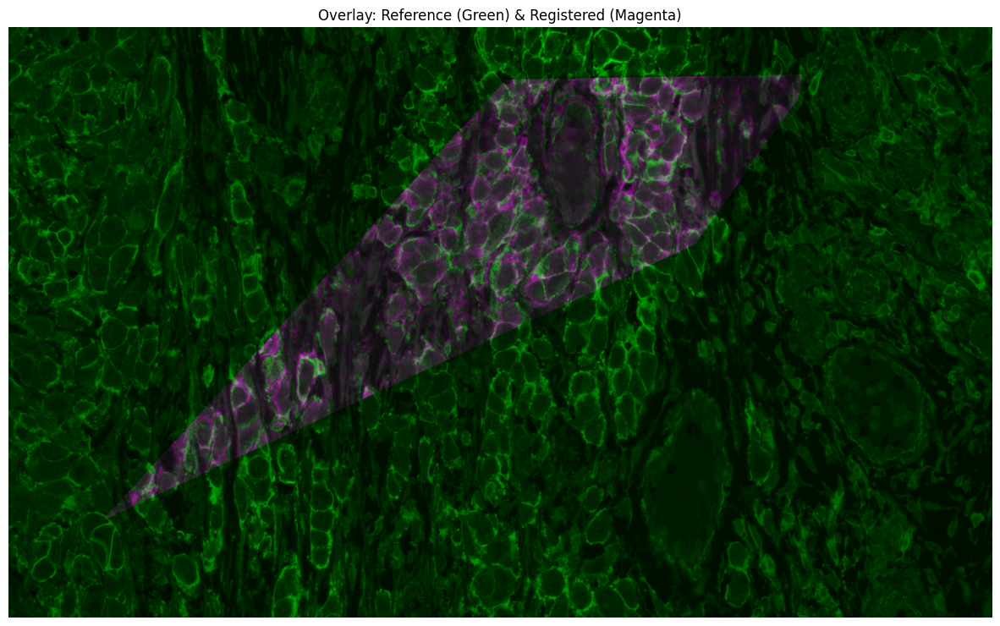

In [11]:
for i, (ch1, ch2) in enumerate(zip(
    [img1_ch1, img1_ch2, img1_ch3],
    [img2_ch1, img2_ch2, img2_ch3]
), start=1):
    print(f"Processing channel {i}...")
    tile_roi1_ch, tile_roi2_ch = extract_and_warp_roi(ch1, ch2, x0, y0, tile_size, H_fullres)
    tile_roi1_ch = normalize_and_clahe(tile_roi1_ch)
    tile_roi2_ch = normalize_and_clahe(tile_roi2_ch)

     # Step 4: Warp and overlay
    warped_ch = piecewise_affine_warp(pts1_consistent, pts2_consistent, tile_roi2_ch)
    plot_overlay(tile_roi1_ch, warped_ch, figsize=(15, 15))
        


# All code together, for different tiles

In [12]:
def get_global_matches_for_tile(
    x0, y0, tile_size,
    img1_enh, img2_enh,
    img1_chs, img2_chs,
    H_fullres,
    n_neighbors=5,
    error_threshold=50.0
):
    """
    Process a tile to extract consistent feature matches between img1 and img2 (merged + channels),
    return matched points in global coordinates.

    Parameters:
    - x0, y0: top-left tile coordinates
    - tile_size: size of square tile
    - img1_enh, img2_enh: merged/combined channels for visualization/matching
    - img1_chs, img2_chs: lists of 3 individual channels (uint16 or uint8)
    - H_fullres: homography from img2 to img1 (fullres)
    - n_neighbors: number of neighbors for local consistency filtering
    - error_threshold: max error for filtering matches

    Returns:
    - pts1_global: consistent keypoints in img1 (global coordinates)
    - pts2_global_original: corresponding keypoints in original img2 (global coordinates)
    """

    def normalize_and_clahe(tile):
        tile = normalize_uint16_to_uint8(tile)
        clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
        return cv2.merge([clahe.apply(c) for c in cv2.split(tile)])

    def get_consistent_matches(tile1, tile2, label=""):
        try:
            H, inliers, pts1, pts2, kp1, kp2 = akaze_feature_matching(
                tile1, tile2, ratio_thresh=0.8, ransac_thresh=500.0
            )
            consistency_flags = check_local_consistency(pts1, pts2, n_neighbors, error_threshold)
            consistent_matches = [m for m, c in zip(inliers, consistency_flags) if c]
            return consistent_matches, kp1, kp2
        except Exception as e:
            print(f"[Warning] {label}: failed to match — {e}")
            return [], [], []

    # Step 1: Extract and normalize merged channel
    tile_roi1_merged, tile_roi2_merged = extract_and_warp_roi(
        img1_enh, img2_enh, x0, y0, tile_size, H_fullres
    )

    all_pts1 = []
    all_pts2 = []

    print("Processing merged image...")
    matches, kp1, kp2 = get_consistent_matches(tile_roi1_merged, tile_roi2_merged, label="merged")
    for m in matches:
        all_pts1.append(kp1[m.queryIdx].pt)
        all_pts2.append(kp2[m.trainIdx].pt)

    # Step 2: Process each individual channel
    for i, (ch1, ch2) in enumerate(zip(img1_chs, img2_chs), start=1):
        print(f"Processing channel {i}...")
        try:
            tile_roi1_ch, tile_roi2_ch = extract_and_warp_roi(ch1, ch2, x0, y0, tile_size, H_fullres)
            tile_roi1_ch = normalize_and_clahe(tile_roi1_ch)
            tile_roi2_ch = normalize_and_clahe(tile_roi2_ch)
            matches, kp1, kp2 = get_consistent_matches(tile_roi1_ch, tile_roi2_ch, label=f"channel {i}")
            for m in matches:
                all_pts1.append(kp1[m.queryIdx].pt)
                all_pts2.append(kp2[m.trainIdx].pt)
        except Exception as e:
            print(f"[Warning] Channel {i}: extraction or normalization failed — {e}")

    # Step 3: Combine and filter globally
    pts1 = np.float32(all_pts1)
    pts2 = np.float32(all_pts2)
    print(f"Total combined matches before global consistency check: {len(pts1)}")

    if len(pts1) < n_neighbors + 1:
        print("[Error] Not enough combined matches for global consistency filtering.")
        return np.empty((0, 2)), np.empty((0, 2))

    consistency_flags = check_local_consistency(pts1, pts2, n_neighbors, error_threshold)
    pts1_consistent = pts1[consistency_flags]
    pts2_consistent = pts2[consistency_flags]
    print(f"After global consistency filtering: {len(pts1_consistent)} matches retained")

    # Step 4: Convert to global coordinates
    pts1_global = pts1_consistent + np.array([x0, y0])
    pts2_global = pts2_consistent + np.array([x0, y0])

    # Optional: Visual debug
    if len(pts1_consistent) >= 3:
        try:
            warped = piecewise_affine_warp(pts1_consistent, pts2_consistent, tile_roi2_merged)
            plot_overlay(tile_roi1_merged, warped, figsize=(10, 10))
            # Step 5: Map pts2 to original img2 space
            H_inv = np.linalg.inv(H_fullres)
            pts2_global_original = cv2.perspectiveTransform(pts2_global[None, :, :], H_inv)[0]
            return pts1_global, pts2_global_original
        except Exception as e:
            print(f"[Warning] Piecewise warp failed: {e}")
    else:
        print("[Warning] Not enough points for piecewise affine warp — skipping overlay.")

    


In [13]:
from tqdm import tqdm

def extract_matches_over_image(
    img1_enh, img2_enh,
    img1_chs, img2_chs,
    H_fullres,
    tile_size=4000,
    stride=None,
    n_neighbors=5,
    error_threshold=50.0
):
    """
    Extract consistent feature matches over the entire image using overlapping tiles.

    Parameters:
    - img1_enh, img2_enh: merged image channels
    - img1_chs, img2_chs: list of individual channels (len=3 each)
    - H_fullres: homography matrix
    - tile_size: size of tile (square)
    - stride: step size for tiling (default = tile_size // 2 for 50% overlap)
    - n_neighbors, error_threshold: params for consistency filtering

    Returns:
    - all_pts1_global, all_pts2_global_original: concatenated matches in global coordinates
    """

    if stride is None:
        stride = tile_size // 2  # default to 50% overlap

    h, w = img1_enh.shape[:2]

    all_pts1_global = []
    all_pts2_global_original = []

    print(f"Tiling image of size {w}x{h} with tile size {tile_size} and stride {stride}...")

    for y0 in tqdm(range(0, h - tile_size + 1, stride)):
        for x0 in range(0, w - tile_size + 1, stride):
            print(f"\n==> Processing tile at ({x0}, {y0})")
            pts1, pts2 = get_global_matches_for_tile(
                x0=x0, y0=y0, tile_size=tile_size,
                img1_enh=img1_enh, img2_enh=img2_enh,
                img1_chs=img1_chs, img2_chs=img2_chs,
                H_fullres=H_fullres,
                n_neighbors=n_neighbors,
                error_threshold=error_threshold
            )

            if len(pts1) > 0:
                all_pts1_global.append(pts1)
                all_pts2_global_original.append(pts2)

    if all_pts1_global:
        all_pts1_global = np.concatenate(all_pts1_global, axis=0)
        all_pts2_global_original = np.concatenate(all_pts2_global_original, axis=0)
    else:
        all_pts1_global = np.empty((0, 2))
        all_pts2_global_original = np.empty((0, 2))

    print(f"\n✅ Total matched points collected: {len(all_pts1_global)}")

    return all_pts1_global, all_pts2_global_original


Tiling image of size 25000x40000 with tile size 8000 and stride 8000...


  0%|                                                                                             | 0/5 [00:00<?, ?it/s]


==> Processing tile at (0, 0)
Processing merged image...
Total matches: 29; Inliers after RANSAC: 20
Processing channel 1...
Total matches: 4; Inliers after RANSAC: 4
[Warning] channel 1: failed to match — Expected n_neighbors <= n_samples_fit, but n_neighbors = 5, n_samples_fit = 4, n_samples = 1
Processing channel 2...
[Warning] channel 2: failed to match — OpenCV(4.11.0) /io/opencv/modules/flann/src/miniflann.cpp:338: error: (-5:Bad argument) Only continuous arrays are supported in function 'buildIndex_'

Processing channel 3...
[Warning] channel 3: failed to match — Not enough good matches for homography estimation.
Total combined matches before global consistency check: 0
[Error] Not enough combined matches for global consistency filtering.

==> Processing tile at (8000, 0)
Processing merged image...
Total matches: 415; Inliers after RANSAC: 84
Processing channel 1...
Total matches: 68; Inliers after RANSAC: 12
Processing channel 2...
Total matches: 89; Inliers after RANSAC: 54
P

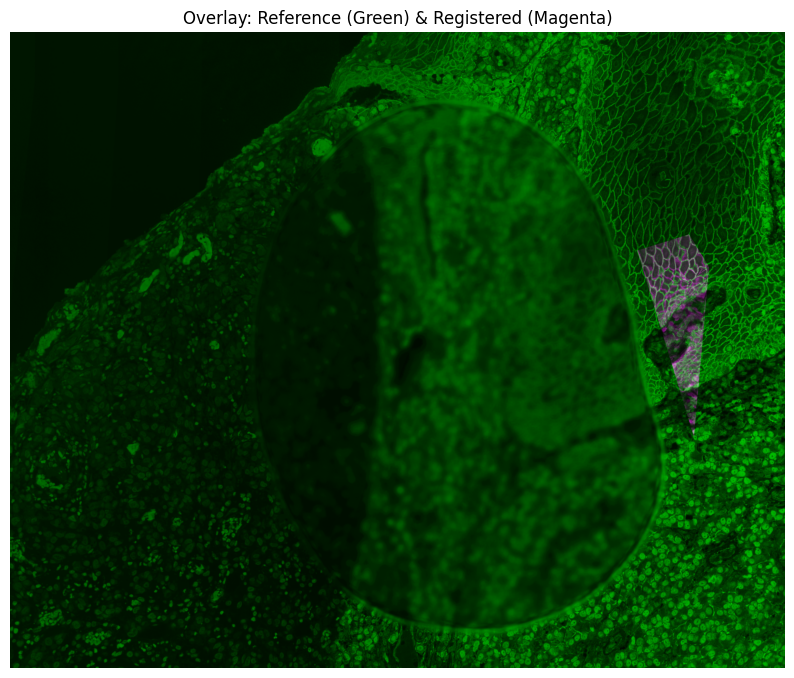


==> Processing tile at (16000, 0)
Processing merged image...
Total matches: 1658; Inliers after RANSAC: 109
Processing channel 1...
Total matches: 766; Inliers after RANSAC: 58
Processing channel 2...
Total matches: 391; Inliers after RANSAC: 61
Processing channel 3...
Total matches: 419; Inliers after RANSAC: 78
Total combined matches before global consistency check: 59
After global consistency filtering: 56 matches retained


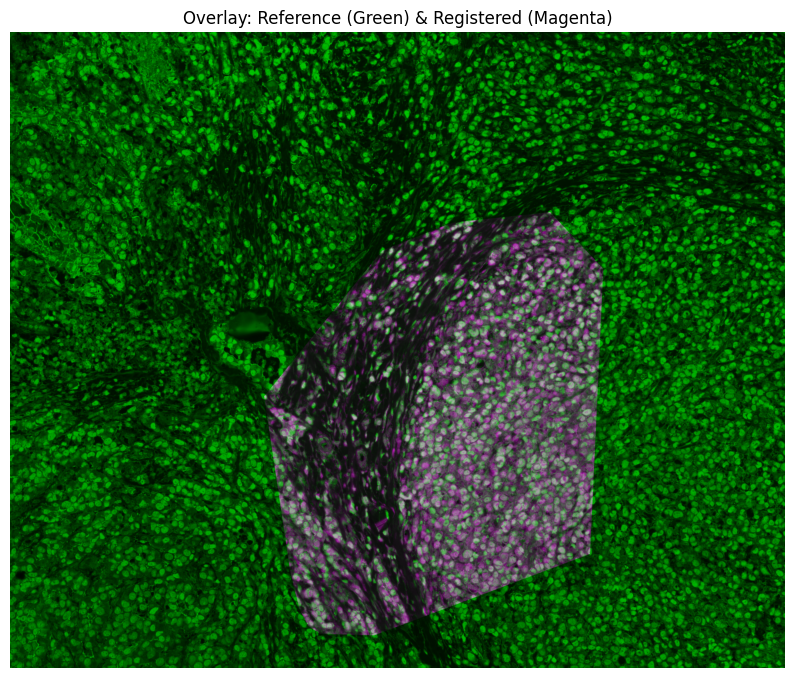

 20%|████████████████▊                                                                   | 1/5 [03:33<14:12, 213.19s/it]


==> Processing tile at (0, 8000)
Processing merged image...
Total matches: 361; Inliers after RANSAC: 42
Processing channel 1...
Total matches: 188; Inliers after RANSAC: 37
Processing channel 2...
Total matches: 499; Inliers after RANSAC: 295
Processing channel 3...
Total matches: 169; Inliers after RANSAC: 41
Total combined matches before global consistency check: 0
[Error] Not enough combined matches for global consistency filtering.

==> Processing tile at (8000, 8000)
Processing merged image...
Total matches: 909; Inliers after RANSAC: 94
Processing channel 1...
Total matches: 557; Inliers after RANSAC: 42
Processing channel 2...
Total matches: 107; Inliers after RANSAC: 27
Processing channel 3...
Total matches: 288; Inliers after RANSAC: 28
Total combined matches before global consistency check: 40
After global consistency filtering: 40 matches retained


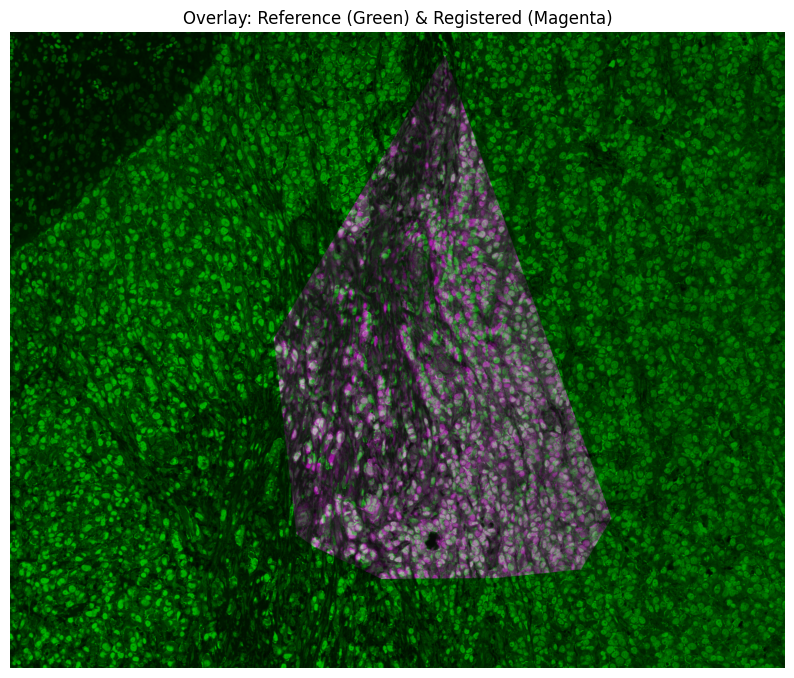


==> Processing tile at (16000, 8000)
Processing merged image...
Total matches: 707; Inliers after RANSAC: 60
Processing channel 1...
Total matches: 226; Inliers after RANSAC: 25
Processing channel 2...
Total matches: 293; Inliers after RANSAC: 88
Processing channel 3...


 40%|█████████████████████████████████▌                                                  | 2/5 [06:28<09:32, 190.71s/it]

Total matches: 69; Inliers after RANSAC: 15
Total combined matches before global consistency check: 0
[Error] Not enough combined matches for global consistency filtering.

==> Processing tile at (0, 16000)
Processing merged image...
Total matches: 1286; Inliers after RANSAC: 85
Processing channel 1...
Total matches: 700; Inliers after RANSAC: 109
Processing channel 2...
Total matches: 791; Inliers after RANSAC: 155
Processing channel 3...
Total matches: 449; Inliers after RANSAC: 62
Total combined matches before global consistency check: 2
[Error] Not enough combined matches for global consistency filtering.

==> Processing tile at (8000, 16000)
Processing merged image...
Total matches: 1322; Inliers after RANSAC: 103
Processing channel 1...
Total matches: 831; Inliers after RANSAC: 95
Processing channel 2...
Total matches: 220; Inliers after RANSAC: 41
Processing channel 3...
Total matches: 300; Inliers after RANSAC: 30
Total combined matches before global consistency check: 65
After

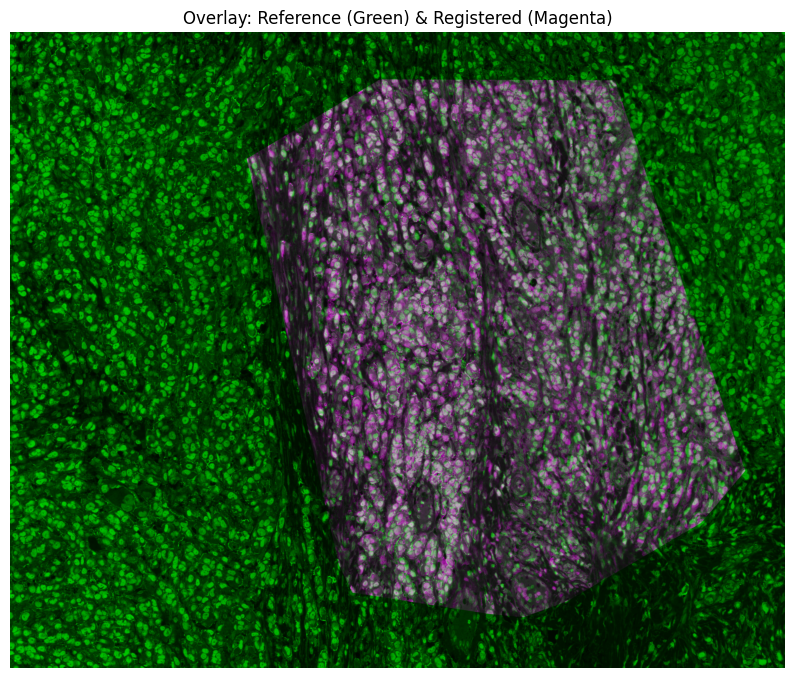


==> Processing tile at (16000, 16000)
Processing merged image...
Total matches: 1188; Inliers after RANSAC: 157
Processing channel 1...
Total matches: 176; Inliers after RANSAC: 54
Processing channel 2...
Total matches: 974; Inliers after RANSAC: 81
Processing channel 3...
Total matches: 174; Inliers after RANSAC: 28
Total combined matches before global consistency check: 107
After global consistency filtering: 107 matches retained


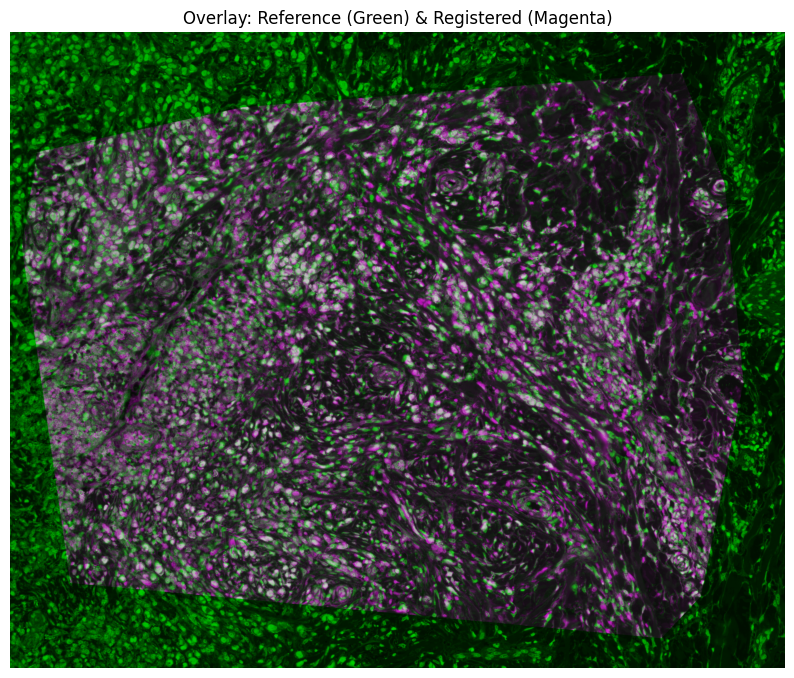

 60%|██████████████████████████████████████████████████▍                                 | 3/5 [10:53<07:29, 224.99s/it]


==> Processing tile at (0, 24000)
Processing merged image...
Total matches: 738; Inliers after RANSAC: 54
Processing channel 1...
Total matches: 255; Inliers after RANSAC: 55
Processing channel 2...
Total matches: 745; Inliers after RANSAC: 130
Processing channel 3...
Total matches: 224; Inliers after RANSAC: 25
Total combined matches before global consistency check: 0
[Error] Not enough combined matches for global consistency filtering.

==> Processing tile at (8000, 24000)
Processing merged image...
Total matches: 1196; Inliers after RANSAC: 69
Processing channel 1...
Total matches: 521; Inliers after RANSAC: 73
Processing channel 2...
Total matches: 230; Inliers after RANSAC: 23
Processing channel 3...
Total matches: 302; Inliers after RANSAC: 27
Total combined matches before global consistency check: 65
After global consistency filtering: 65 matches retained


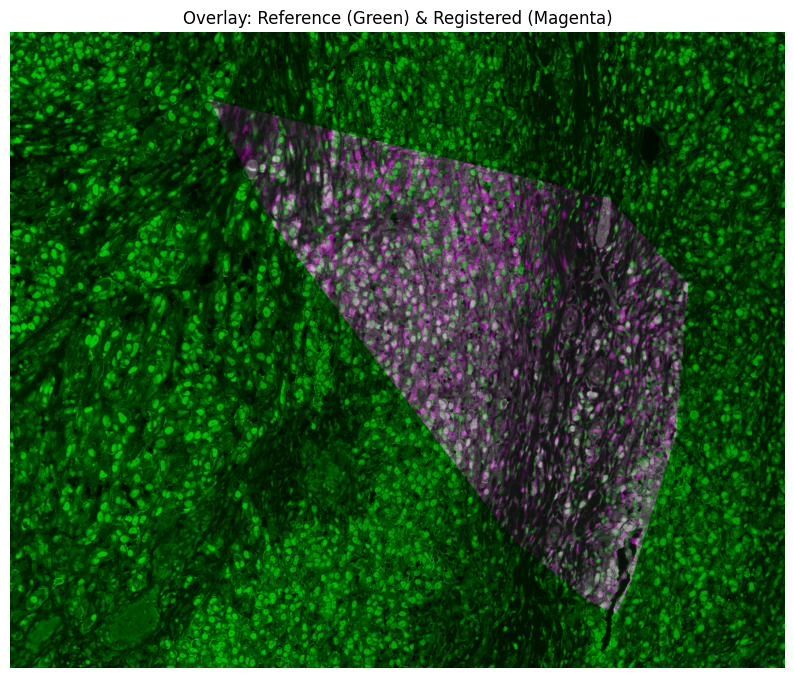


==> Processing tile at (16000, 24000)
Processing merged image...
Total matches: 742; Inliers after RANSAC: 73
Processing channel 1...
Total matches: 5; Inliers after RANSAC: 5
Processing channel 2...
Total matches: 717; Inliers after RANSAC: 69
Processing channel 3...
Total matches: 111; Inliers after RANSAC: 19
Total combined matches before global consistency check: 35
After global consistency filtering: 35 matches retained


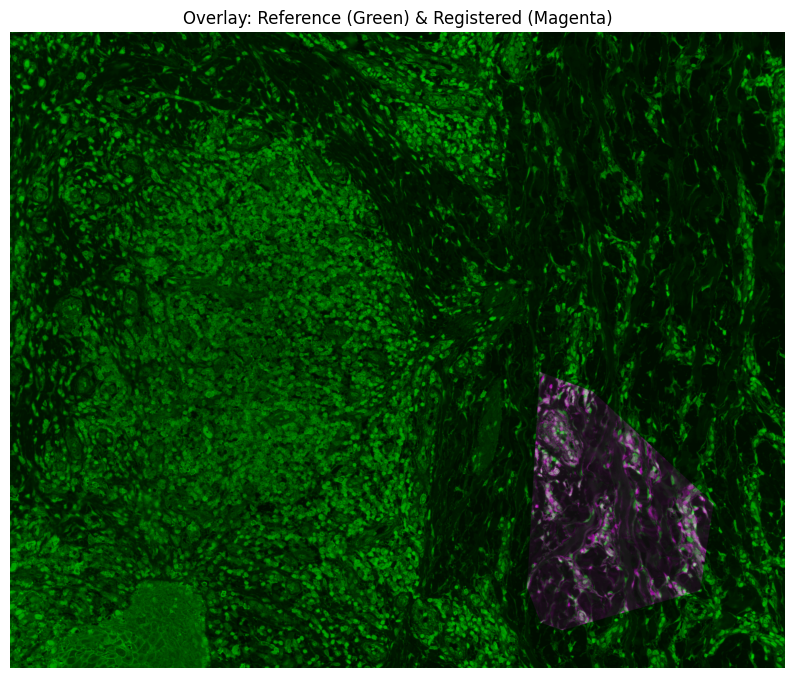

 80%|███████████████████████████████████████████████████████████████████▏                | 4/5 [14:36<03:43, 223.96s/it]


==> Processing tile at (0, 32000)
Processing merged image...
Total matches: 307; Inliers after RANSAC: 50
Processing channel 1...
Total matches: 143; Inliers after RANSAC: 61
Processing channel 2...
[Warning] channel 2: failed to match — OpenCV(4.11.0) /io/opencv/modules/flann/src/miniflann.cpp:338: error: (-5:Bad argument) Only continuous arrays are supported in function 'buildIndex_'

Processing channel 3...
Total matches: 256; Inliers after RANSAC: 75
Total combined matches before global consistency check: 0
[Error] Not enough combined matches for global consistency filtering.

==> Processing tile at (8000, 32000)
Processing merged image...
Total matches: 1127; Inliers after RANSAC: 107
Processing channel 1...
Total matches: 541; Inliers after RANSAC: 50
Processing channel 2...
Total matches: 232; Inliers after RANSAC: 85
Processing channel 3...
Total matches: 629; Inliers after RANSAC: 50
Total combined matches before global consistency check: 63
After global consistency filtering

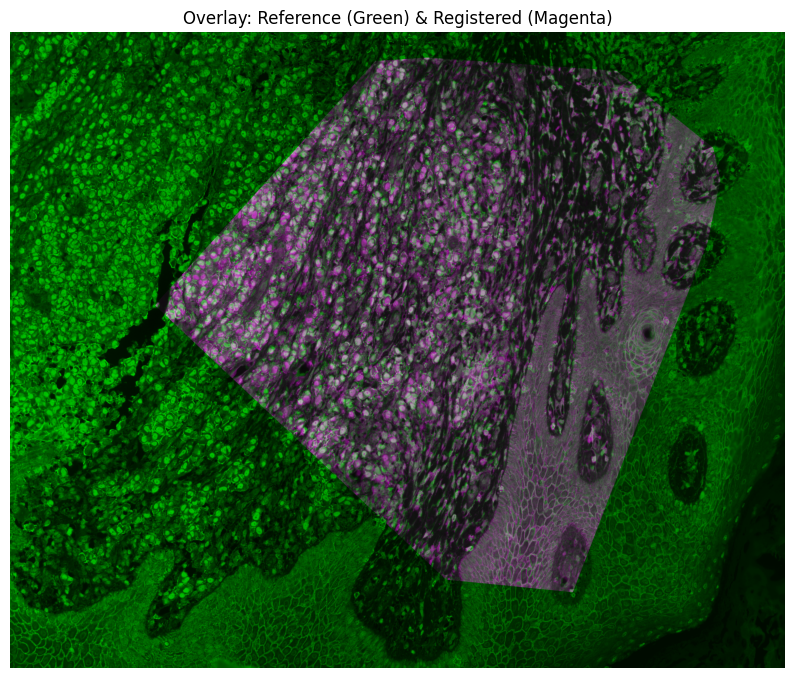


==> Processing tile at (16000, 32000)
Processing merged image...
Total matches: 634; Inliers after RANSAC: 44
Processing channel 1...
[Warning] channel 1: failed to match — Not enough good matches for homography estimation.
Processing channel 2...
Total matches: 434; Inliers after RANSAC: 46
Processing channel 3...
Total matches: 183; Inliers after RANSAC: 23
Total combined matches before global consistency check: 29
After global consistency filtering: 23 matches retained


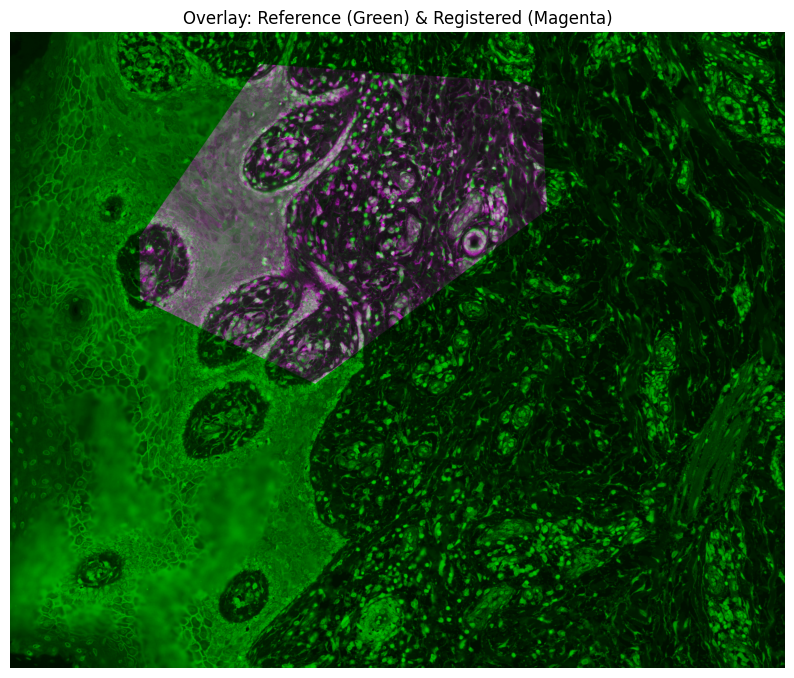

100%|████████████████████████████████████████████████████████████████████████████████████| 5/5 [18:20<00:00, 220.01s/it]


✅ Total matched points collected: 487


In [14]:
pts1_all, pts2_all = extract_matches_over_image(
    img1_enh=img1_enh,
    img2_enh=img2_enh,
    img1_chs=[img1_ch1, img1_ch2, img1_ch3],
    img2_chs=[img2_ch1, img2_ch2, img2_ch3],
    H_fullres=H_fullres,
    tile_size=8000,
    stride=8000,  # 50% overlap
    n_neighbors=5,
    error_threshold=50.0
)


In [16]:
    # Step 3: Combine and filter globally
pts1_all = np.float32(pts1_all)
pts2_all = np.float32(pts2_all)
print(f"Total combined matches before global consistency check: {len(pts1_all)}")

n_neighbors=5
error_threshold=50.0

consistency_flags = check_local_consistency(pts1_all, pts2_all, n_neighbors, error_threshold)

pts1_consistent = pts1_all[consistency_flags]
pts2_consistent = pts2_all[consistency_flags]
print(f"After global consistency filtering: {len(pts1_consistent)} matches retained")

img2_gray = cv2.cvtColor(img2_enh, cv2.COLOR_BGR2GRAY)
img1_gray = cv2.cvtColor(img1_enh, cv2.COLOR_BGR2GRAY)

Total combined matches before global consistency check: 487
After global consistency filtering: 487 matches retained


# Apply it globally (Not recommmended- memory issues)

In [ ]:
warped = piecewise_affine_warp(pts1_consistent, pts2_consistent, img2_gray)
plot_overlay(img1_gray, warped, figsize=(20, 20))

In [171]:
import matplotlib.pyplot as plt
import numpy as np

def plot_point_mappings(pts1, pts2, background_img1=None, background_img2=None, title="Point correspondences", alpha1=0.8, alpha2=0.8):
    plt.figure(figsize=(10, 10))

    # Plot first background image if provided
    if background_img1 is not None:
        plt.imshow(background_img1, cmap='gray', alpha=alpha1)

    # Plot second background image if provided
    if background_img2 is not None:
        plt.imshow(background_img2, cmap='hot', alpha=alpha2)  # or another colormap

    # Plot pts1 as red dots
    plt.scatter(pts1[:, 0], pts1[:, 1], color='red', label='pts1 (reference)', s=10)

    # Plot pts2 as blue arrows starting from pts1
    deltas = pts2 - pts1
    plt.quiver(
        pts1[:, 0], pts1[:, 1],   # origins
        deltas[:, 0], deltas[:, 1],  # displacements
        angles='xy', scale_units='xy', scale=1, color='blue', width=0.0025
    )

    plt.legend()
    plt.title(title)
    plt.axis('equal')
    plt.grid(True)
    #plt.gca().invert_yaxis()
    plt.show()


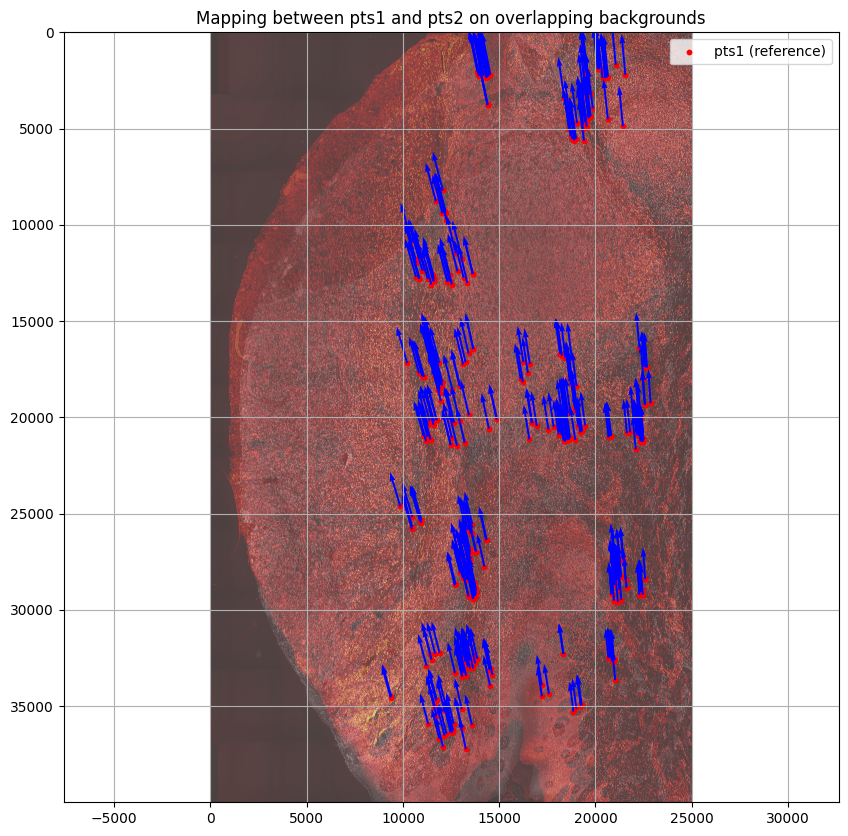

In [172]:
plot_point_mappings(
    pts1_consistent, pts2_consistent,
    background_img1=img1_gray,
    background_img2=img2_gray,
    alpha1=0.6, alpha2=0.4,
    title="Mapping between pts1 and pts2 on overlapping backgrounds"
)


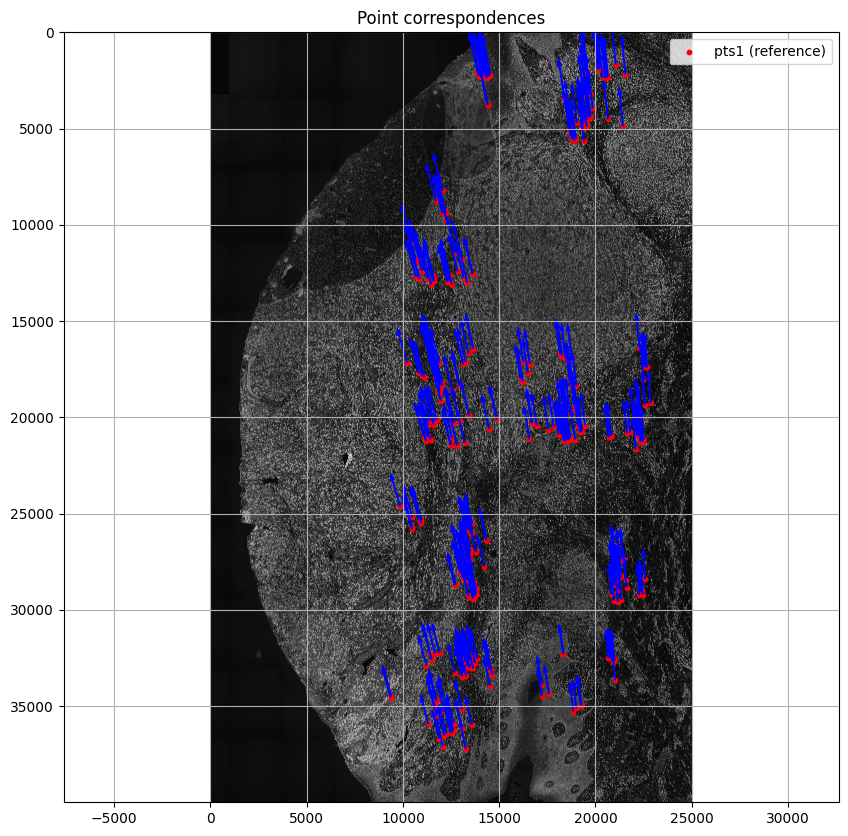

In [49]:
plot_point_mappings(pts1_consistent, pts2_consistent,background_img=img2_gray)


# Work no on downscaled images

In [196]:
# --- Downsample ---
scale = 0.1
img1_red = cv2.resize(img1_enh, None, fx=scale, fy=scale, interpolation=cv2.INTER_AREA)
img2_red = cv2.resize(img2_enh, None, fx=scale, fy=scale, interpolation=cv2.INTER_AREA)


In [197]:
img1_red = cv2.cvtColor(img1_red, cv2.COLOR_BGR2GRAY)
img2_red = cv2.cvtColor(img2_red, cv2.COLOR_BGR2GRAY)

In [198]:
pts1_scaled=pts1_consistent*scale
pts2_scaled=pts2_consistent*scale

warped = piecewise_affine_warp(pts1_scaled, pts2_scaled, img2_red)


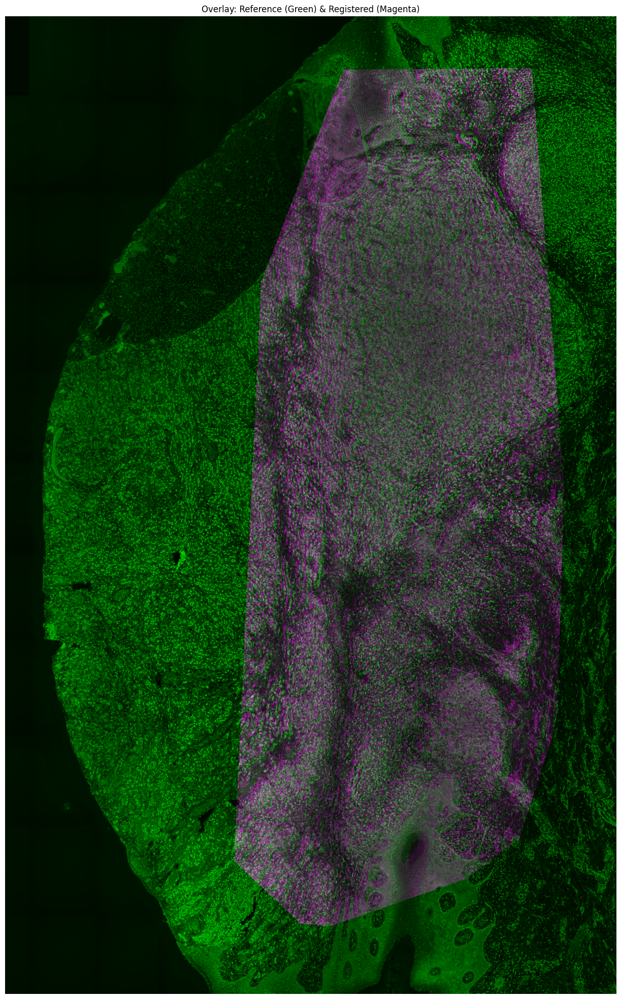

In [199]:
plot_overlay(img1_red, warped, figsize=(25, 25))

In [140]:
roi = (30000, 10000, 5000, 5000)

In [141]:
pts1_consistent_rev = pts1_consistent[:, ::-1]
pts2_consistent_rev = pts2_consistent[:, ::-1]


In [142]:
import numpy as np
import cv2
from scipy.spatial import Delaunay
from scipy.ndimage import map_coordinates

# Assume these are defined somewhere before:
# pts1_consistent: (N, 2) array of matched points in img1 (x, y)
# pts2_consistent: (N, 2) array of matched points in img2 (x, y)
# img2_gray: source grayscale image (img2) as a 2D numpy array
# roi = (x, y, w, h) in img1 coordinate system

x, y, w, h = roi

# 1. Delaunay triangulation on pts1
tri = Delaunay(pts1_consistent_rev)

# 2. Meshgrid of all pixel coords in ROI
xv, yv = np.meshgrid(np.arange(x, x + w), np.arange(y, y + h))
coords = np.stack([xv.ravel(), yv.ravel()], axis=-1).astype(np.float32)  # (num_pixels, 2)



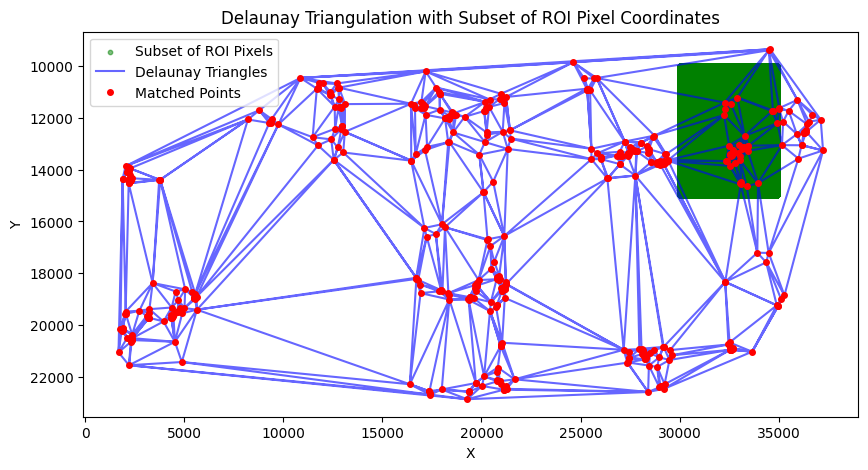

In [144]:
subset_coords = coords[::100]  # Take every 100th point
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))

plt.scatter(subset_coords[:, 0], subset_coords[:, 1], s=10, color='green', alpha=0.5, label='Subset of ROI Pixels')
plt.triplot(pts1_consistent_rev[:, 0], pts1_consistent_rev[:, 1], tri.simplices.copy(), color='blue', alpha=0.6, label='Delaunay Triangles')
plt.plot(pts1_consistent_rev[:, 0], pts1_consistent_rev[:, 1], 'o', color='red', markersize=4, label='Matched Points')

plt.gca().invert_yaxis()
plt.title('Delaunay Triangulation with Subset of ROI Pixel Coordinates')
plt.xlabel('X')
plt.ylabel('Y')
plt.legend()
plt.show()


In [159]:
# 3. Find which triangle each pixel belongs to (-1 if outside)
simplex_indices = tri.find_simplex(coords)

# 4. Prepare output image patch
warped_roi = np.zeros((w, h), dtype=img2_gray.dtype)

# 5. Loop over all triangles that have pixels inside
for tri_idx in np.unique(simplex_indices):
    if tri_idx == -1:
        continue  # skip pixels outside

    # Mask for pixels inside this triangle
    mask = simplex_indices == tri_idx
    coords_in_tri = coords[mask]

    # Triangle corners in pts1 and pts2
    tri_pts1 = pts1_consistent[tri.simplices[tri_idx]]
    tri_pts2 = pts2_consistent[tri.simplices[tri_idx]]

    # Check triangle area to avoid degenerate transforms
    area = 0.5 * abs(
        tri_pts1[0,0]*(tri_pts1[1,1]-tri_pts1[2,1]) +
        tri_pts1[1,0]*(tri_pts1[2,1]-tri_pts1[0,1]) +
        tri_pts1[2,0]*(tri_pts1[0,1]-tri_pts1[1,1])
    )
    if area < 1.0:
        continue

    # Get affine transform from pts1 to pts2
    A = cv2.getAffineTransform(tri_pts1.astype(np.float32), tri_pts2.astype(np.float32))

    # Prepare homogeneous coords (x,y,1)
    coords_h = np.hstack([coords_in_tri, np.ones((coords_in_tri.shape[0], 1), dtype=np.float32)])

    # Apply affine transform (to img2 coords)
    mapped = (A @ coords_h.T).T  # (N, 2) in (x,y) format

    # Prepare coords for interpolation (y, x) order
    mapped_coords = np.stack([mapped[:,1], mapped[:,0]], axis=0)

    # Sample pixels from img2_gray
    sampled_vals = map_coordinates(img2_gray.transpose(), mapped_coords, order=1, mode='reflect')

    # Calculate output pixel indices relative to ROI (0-based)
    out_x = (coords_in_tri[:, 0] - x).astype(int)
    out_y = (coords_in_tri[:, 1] - y).astype(int)

    # Fill output patch
    warped_roi[out_y, out_x] = sampled_vals.astype(img2_gray.dtype)

# Now warped_roi contains the warped ROI patch of img2_gray into img1 coords


In [160]:
roi_warped=warped_roi

In [161]:
roi_1=img1_gray[roi[1]:roi[1]+roi[3],roi[0]:roi[0]+roi[2]]

In [162]:
plot_overlay(roi_1, roi_warped, figsize=(20, 20))

ValueError: could not broadcast input array from shape (5000,5000) into shape (5000,0)

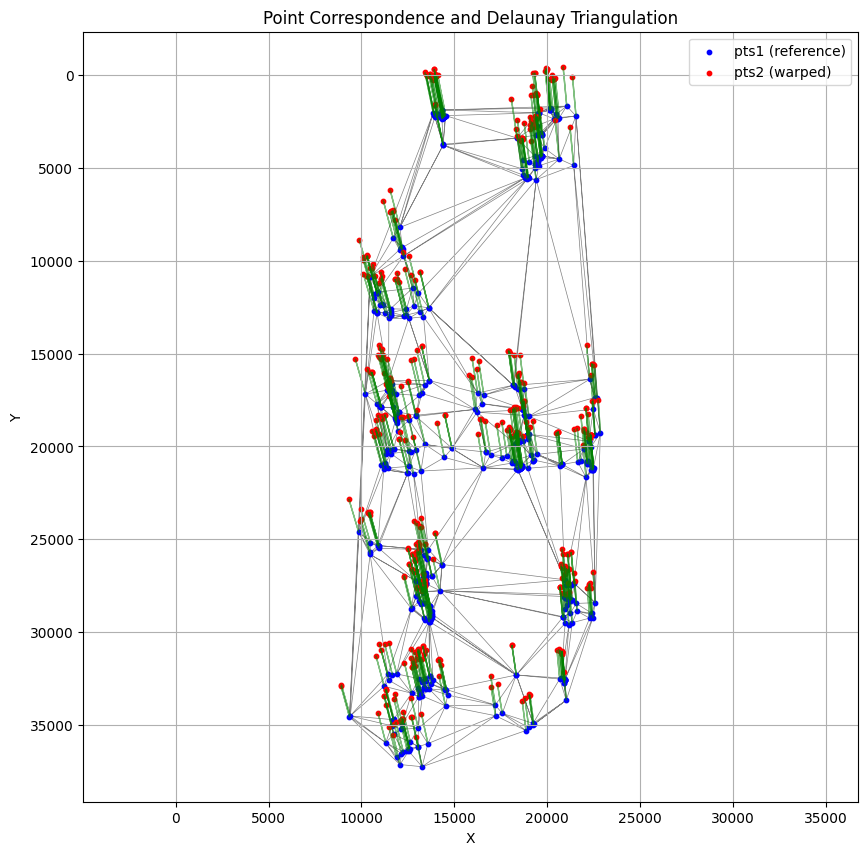

In [84]:
import matplotlib.pyplot as plt
from scipy.spatial import Delaunay
import numpy as np

def plot_correspondence_with_triangulation(pts1, pts2):
    pts1 = np.asarray(pts1)
    pts2 = np.asarray(pts2)

    # Create Delaunay triangulation on pts1
    tri = Delaunay(pts1)

    plt.figure(figsize=(10, 10))
    
    # Plot triangulation
    plt.triplot(pts1[:, 0], pts1[:, 1], tri.simplices, color='gray', linewidth=0.5)
    
    # Plot original points
    plt.scatter(pts1[:, 0], pts1[:, 1], c='blue', label='pts1 (reference)', s=10)
    plt.scatter(pts2[:, 0], pts2[:, 1], c='red', label='pts2 (warped)', s=10)

    # Draw arrows between corresponding points
    for p1, p2 in zip(pts1, pts2):
        plt.arrow(p1[0], p1[1], p2[0] - p1[0], p2[1] - p1[1],
                  color='green', alpha=0.5, head_width=5, length_includes_head=True)

    plt.gca().invert_yaxis()  # Optional for image-style coordinate systems
    plt.legend()
    plt.title("Point Correspondence and Delaunay Triangulation")
    plt.xlabel("X")
    plt.ylabel("Y")
    plt.axis('equal')
    plt.grid(True)
    plt.show()

# Usage:
plot_correspondence_with_triangulation(pts1_consistent, pts2_consistent)


# This is previous code

In [217]:
# 2. Define TPS warp functions using radial basis functions (thin_plate)
def tps_warp_points(pts_src, pts_dst, points_to_warp):
    """
    Warp points_to_warp from pts_src coordinate space into pts_dst coordinate space using TPS.
    pts_src: Nx2 array of control points in source
    pts_dst: Nx2 array of control points in destination
    points_to_warp: Mx2 array of points to warp
    """
    # Separate X and Y for control points
    x_src, y_src = pts_src[:, 0], pts_src[:, 1]
    x_dst, y_dst = pts_dst[:, 0], pts_dst[:, 1]
    # Create RBF interpolators for x and y coordinates separately
    rbf_x = Rbf(x_src, y_src, x_dst, function='thin_plate')
    rbf_y = Rbf(x_src, y_src, y_dst, function='thin_plate')
    # Apply TPS warp
    x_warped = rbf_x(points_to_warp[:, 0], points_to_warp[:, 1])
    y_warped = rbf_y(points_to_warp[:, 0], points_to_warp[:, 1])
    warped_points = np.vstack([x_warped, y_warped]).T
    return warped_points
# 3. Create a mesh grid of all points in roi2_gray (moving image)
h, w = tile_roi2.shape
grid_x, grid_y = np.meshgrid(np.arange(w), np.arange(h))
points_grid = np.vstack([grid_x.ravel(), grid_y.ravel()]).T  # all pixel coords in roi2
# 4. Warp all points in moving image to reference frame
warped_points = tps_warp_points(pts_mov, pts_ref, points_grid)
# 5. Use cv2.remap to warp roi2_gray according to warped points
# remap needs maps for x and y with float32 type and shape of image
map_x = warped_points[:, 0].reshape(h, w).astype(np.float32)
map_y = warped_points[:, 1].reshape(h, w).astype(np.float32)
# Warp roi2_gray to roi1_gray space
roi2_tps_warped = cv2.remap(tile_roi2, map_x, map_y, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)


In [220]:




# Example usage
# tile_roi2 is your moving image
# pts_mov: Nx2 array of moving control points (in tile_roi2)
# pts_ref: Nx2 array of corresponding points in the reference frame (roi1)



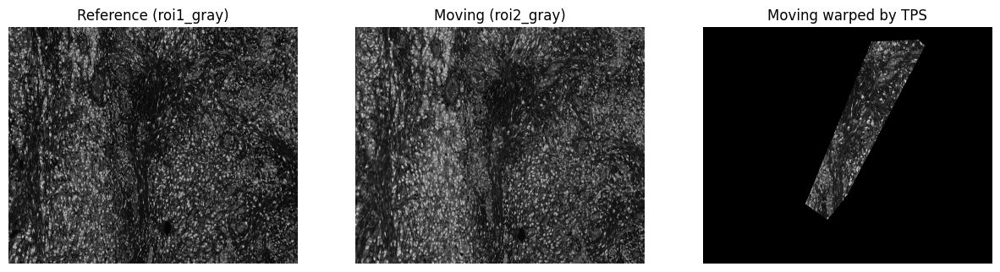

In [221]:
# 6. Show results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title('Reference (roi1_gray)')
plt.imshow(tile_roi1, cmap='gray')
plt.axis('off')
plt.subplot(1, 3, 2)
plt.title('Moving (roi2_gray)')
plt.imshow(tile_roi2, cmap='gray')
plt.axis('off')
plt.subplot(1, 3, 3)
plt.title('Moving warped by TPS')
plt.imshow(roi2_warped, cmap='gray')
plt.axis('off')
plt.show()

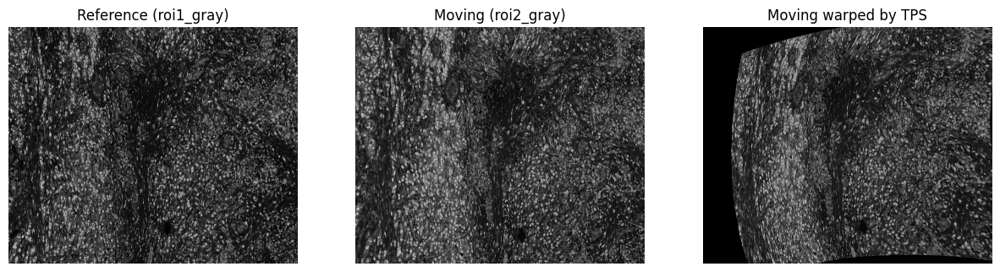

In [218]:
# 6. Show results
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title('Reference (roi1_gray)')
plt.imshow(tile_roi1, cmap='gray')
plt.axis('off')
plt.subplot(1, 3, 2)
plt.title('Moving (roi2_gray)')
plt.imshow(tile_roi2, cmap='gray')
plt.axis('off')
plt.subplot(1, 3, 3)
plt.title('Moving warped by TPS')
plt.imshow(roi2_tps_warped, cmap='gray')
plt.axis('off')
plt.show()

In [297]:
s = 0.01 # downscale factor
S = np.array([[s, 0, 0],
              [0, s, 0],
              [0, 0, 1]])
S_inv = np.linalg.inv(S)

H_full = S_inv @ H @ S


# Example usage:
roi = (0, 15000, 15000, 15000)
x, y, w, h = roi
roi1=img1_enh[x:x+w,y:y+h]
roi2=img2_enh[x:x+w,y:y+h]


height, width = roi1.shape[:2]
roi2_aligned = cv2.warpPerspective(roi2, H_full, (width, height))

roi2_coords = (2000, 2000, 8000, 8000)
x, y, w, h = roi2_coords
roi1sel=roi1[x:x+w,y:y+h]
roi2sel=roi2_aligned[x:x+w,y:y+h]

roi1_gray = cv2.cvtColor(roi1sel, cv2.COLOR_BGR2GRAY)
roi2_gray = cv2.cvtColor(roi2sel, cv2.COLOR_BGR2GRAY)

img1_norm = roi1_gray.astype(np.float32) / 255.0
img2_norm = roi2_gray.astype(np.float32) / 255.0